In [1]:
import numpy as np # linear algebra
import pandas as pd
import matplotlib.pyplot as plt # to show images
from PIL import Image # to read images
import os
from glob import glob
import cv2

In [139]:
person_attribute_names = {}
person_attribute_names['person_attribute_demo'] = ['AgeLess16', 'Age17-30', 'Age31-45', 'Age46-60', 'AgeOver60', 'Female', 'Male']


def _convert_id_to_name(id_str_list, attr_name_mappings):
    """convert class id to class name

    Args:
        id_str_list (list): class id list 
        attr_name_mappings (dict): class name list for each dataset type

    Returns:
        [list]: class name list
    """
    label_ids = id_str_list.split()
    map_object = map(int, label_ids)
    id_num_list = list(map_object)

    attr_name_list = [attr_name_mappings[int(i)] for i in id_num_list]
    return attr_name_list
    
    
def plot_bboxes(df, img_dir, pred_images_dir=None, save_images=True, extension=None, resize=True, only_bbox=False):
    """ Plot bounding boxes in a image and save them.

    Args:
        df (pd.DataFrame): dataframe containing image ids
        img_dir (str): path to original images
        pred_images_dir (str): path to save output images.
        save_images (bool, optional): if True, save gt images
    """
    # Annotate and plot
    image_path_list = df['image_path'].unique().tolist()
    image_list = [image_path.split('/')[-1] for image_path in image_path_list]

    for i, im_file in enumerate(image_list[:10], start=1):
        if i > 5:
            break
        fig, ax = plt.subplots(1, 1, figsize=(30, 25))
        target_df = df[df['image_id']==im_file.split('.')[0]]
        if extension is not None:
            img = cv2.imread(f'{img_dir}/{str(im_file)}.{extension}')
        else:
            img = cv2.imread(f'{img_dir}/{str(im_file)}')
        if img is None:
            if extension is not None:
                print(f'{img_dir}/{str(im_file)}.{extension} is None.')
            else:
                print(f'{img_dir}/{str(im_file)} is None.')

        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        if resize:
            width = 512
            height = 512
            dim = (width, height)
            # resize image
            img = cv2.resize(img, dim, interpolation = cv2.INTER_AREA)

        for i, row in target_df.iterrows():
            cv2.rectangle(img, (int(row.xmin), int(row.ymin)), (int(row.xmax), int(row.ymax)), color=(0,255,0), thickness=2)
            if not only_bbox:
                pred_attr_names = _convert_id_to_name(row.attr_id, person_attribute_names['person_attribute_demo'])
                if 'Female' in pred_attr_names:
                    test_color = (255,20,0)
                else:
                    test_color = (0,100,255)
                pred_attr_name = ' '.join(pred_attr_names)
                cv2.putText(img, f'{pred_attr_name}', (int(row.xmin), int(row.ymin)), cv2.FONT_HERSHEY_SIMPLEX, 2, test_color, 5, cv2.LINE_AA) #0.4

        ax.set_axis_off()
        ax.set_title(f'{im_file}')
        ax.imshow(img)

        if save_images and pred_images_dir is not None:
            os.makedirs(pred_images_dir, exist_ok=True)
            fig.savefig(f'{pred_images_dir}/gt_{im_file}', bbox_inches='tight')
            plt.close(fig)
            print(f'Sample Image Saved to: {pred_images_dir}/gt_{im_file}')

In [92]:
!ls -lt /data1/r_suzuki/pipeline/BaseModel/models/resnet50_defaults/20201207_20_21_34/result/demo_2/result.pkl

-rw-rw-r-- 1 r_suzuki r_suzuki 13438 Dec 18 21:12 /data1/r_suzuki/pipeline/BaseModel/models/resnet50_defaults/20201207_20_21_34/result/demo_2/result.pkl


In [105]:
cls_result = pd.read_pickle('/data1/r_suzuki/pipeline/BaseModel/models/resnet50_defaults/20201207_20_21_34/result/demo_2/result.pkl')

In [106]:
cls_result

,image_id,class_id
0,P1033674_00835_190.jpg,2 5
1,P1033674_01042_348.jpg,2 6
2,P1033674_01188_414.jpg,6
3,P1033674_01050_351.jpg,2 5
4,P1033674_00624_142.jpg,2 6
...,...,...
411,P1033674_01123_386.jpg,2 6
412,P1033674_00994_315.jpg,2 6
413,P1033674_00958_265.jpg,2 6
414,P1033674_00331_80.jpg,2 5


In [107]:
cls_result = cls_result.sort_values(by=['image_id'])
cls_result = cls_result.reset_index(drop=True)
cls_result = cls_result.sort_values(by=['image_id'])
cls_result = cls_result.rename(columns={'class_id': 'attr_id', 'image_id': 'object_id'})

In [108]:
cls_result

,object_id,attr_id
0,P1033674_00021_0.jpg,1 6
1,P1033674_00028_1.jpg,2 6
2,P1033674_00029_2.jpg,2 6
3,P1033674_00030_3.jpg,1 6
4,P1033674_00031_4.jpg,1 6
...,...,...
411,P1033674_01180_411.jpg,2 6
412,P1033674_01183_412.jpg,6
413,P1033674_01187_413.jpg,2 6
414,P1033674_01188_414.jpg,6


In [97]:
!ls -lt /data1/r_suzuki/pipeline/BaseModel/models/effdet_person_ca_v5/20201010_00_40_05/result/person_attribute_demo/result_2.pkl

-rw-rw-r-- 1 r_suzuki r_suzuki 110250 Dec 18 21:09 /data1/r_suzuki/pipeline/BaseModel/models/effdet_person_ca_v5/20201010_00_40_05/result/person_attribute_demo/result_2.pkl


In [145]:
detection_result_df = pd.read_csv('/data1/r_suzuki/pipeline/BaseModel/models/effdet_person_ca_v5/20201010_00_40_05/result/person_attribute_demo_4/all_features.csv', dtype={'image_id': str})
detection_result_df.to_pickle('/data1/r_suzuki/pipeline/BaseModel/models/effdet_person_ca_v5/20201010_00_40_05/result/person_attribute_demo_4/result.pkl')

In [144]:
detection_result_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1636 entries, 0 to 1635
Data columns (total 17 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   image_id      1636 non-null   object 
 1   image_path    1636 non-null   object 
 2   id            1636 non-null   float64
 3   class_id      1636 non-null   int64  
 4   outside       1636 non-null   float64
 5   occluded      1636 non-null   float64
 6   keyframe      1636 non-null   float64
 7   xmin          1636 non-null   float64
 8   ymin          1636 non-null   float64
 9   xmax          1636 non-null   float64
 10  ymax          1636 non-null   float64
 11  z_order       1636 non-null   float64
 12  image_height  1636 non-null   float64
 13  image_width   1636 non-null   float64
 14  width         1636 non-null   float64
 15  height        1636 non-null   float64
 16  area          1636 non-null   float64
dtypes: float64(14), int64(1), object(2)
memory usage: 217.4+ KB


In [113]:
detection_result_df

,image_id,image_path,id,class_id,outside,occluded,keyframe,xmin,ymin,xmax,ymax,z_order,image_height,image_width,width,height,area
0,video_3_00154,/data1/r_suzuki/pipeline/BaseModel/data/person...,0.0,1,0.0,0.0,0.0,830.0,88.0,1487.0,1974.0,5.0,2160.0,3840.0,657.0,1886.0,1239102.0
1,video_3_00154,/data1/r_suzuki/pipeline/BaseModel/data/person...,1.0,1,0.0,0.0,0.0,1498.0,170.0,2003.0,1946.0,6.0,2160.0,3840.0,505.0,1776.0,896880.0
2,video_3_00154,/data1/r_suzuki/pipeline/BaseModel/data/person...,2.0,1,0.0,0.0,0.0,2060.0,255.0,2687.0,1884.0,8.0,2160.0,3840.0,627.0,1629.0,1021383.0
3,video_3_00154,/data1/r_suzuki/pipeline/BaseModel/data/person...,3.0,1,0.0,0.0,0.0,2629.0,93.0,3300.0,2027.0,9.0,2160.0,3840.0,671.0,1934.0,1297714.0
4,video_3_00081,/data1/r_suzuki/pipeline/BaseModel/data/person...,0.0,1,0.0,0.0,0.0,863.0,98.0,1487.0,1960.0,5.0,2160.0,3840.0,624.0,1862.0,1161888.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1635,video_3_00316,/data1/r_suzuki/pipeline/BaseModel/data/person...,3.0,1,0.0,0.0,0.0,2708.0,303.0,3370.0,2144.0,9.0,2160.0,3840.0,662.0,1841.0,1218742.0
1636,video_3_00298,/data1/r_suzuki/pipeline/BaseModel/data/person...,0.0,1,0.0,0.0,0.0,830.0,302.0,1471.0,2082.0,5.0,2160.0,3840.0,641.0,1780.0,1140980.0
1637,video_3_00298,/data1/r_suzuki/pipeline/BaseModel/data/person...,1.0,1,0.0,0.0,0.0,1508.0,370.0,2084.0,2061.0,6.0,2160.0,3840.0,576.0,1691.0,974016.0
1638,video_3_00298,/data1/r_suzuki/pipeline/BaseModel/data/person...,2.0,1,0.0,0.0,0.0,2063.0,468.0,2631.0,2027.0,8.0,2160.0,3840.0,568.0,1559.0,885512.0


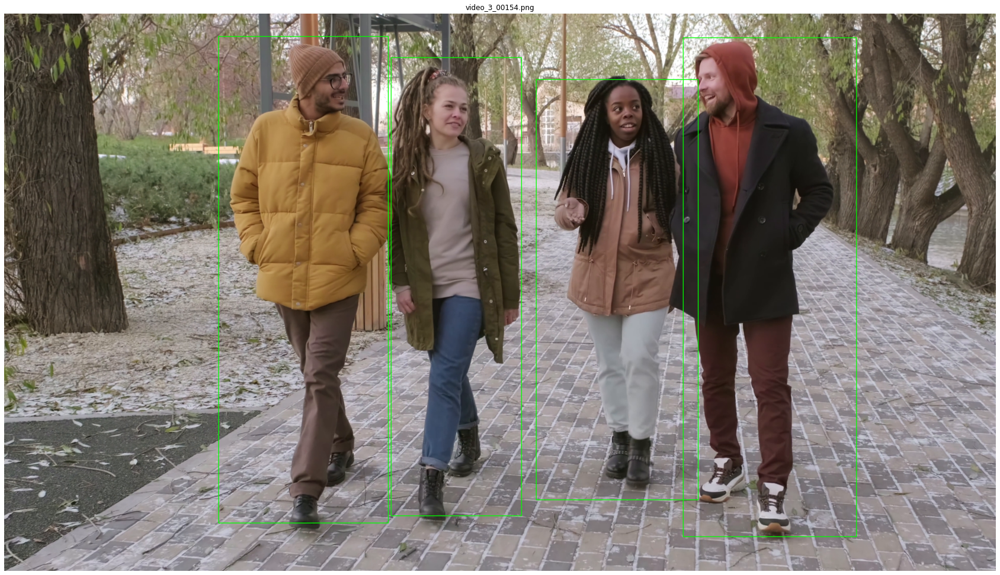

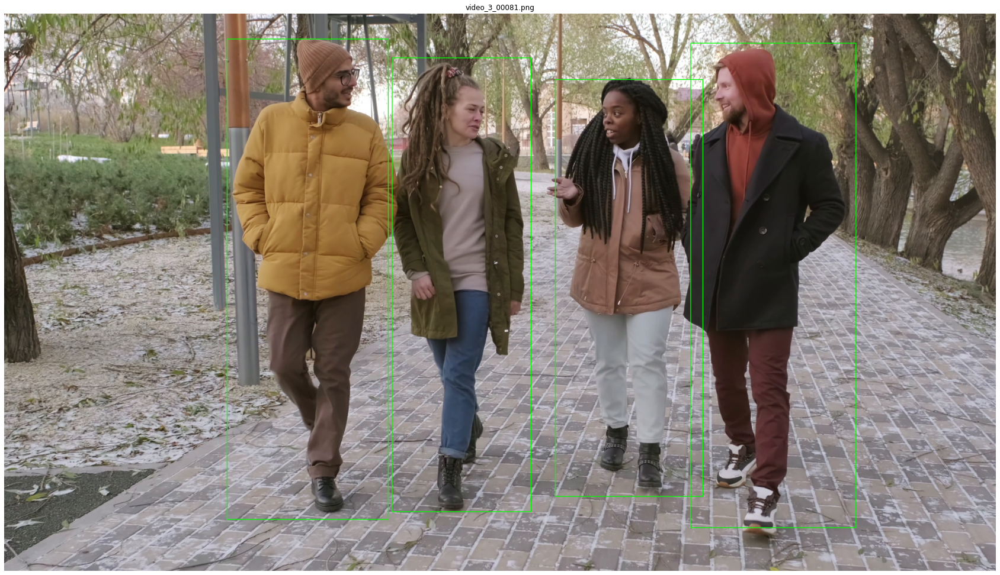

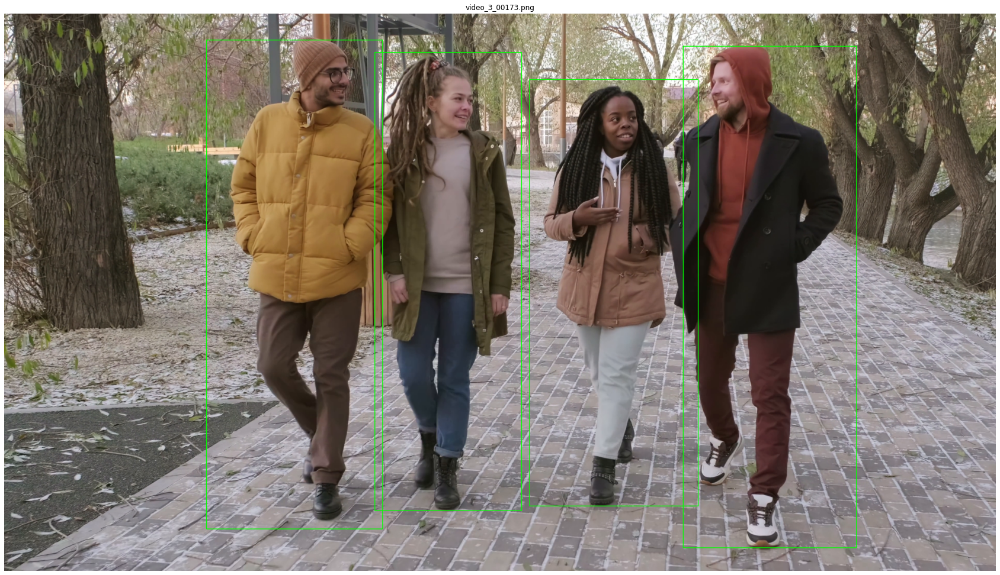

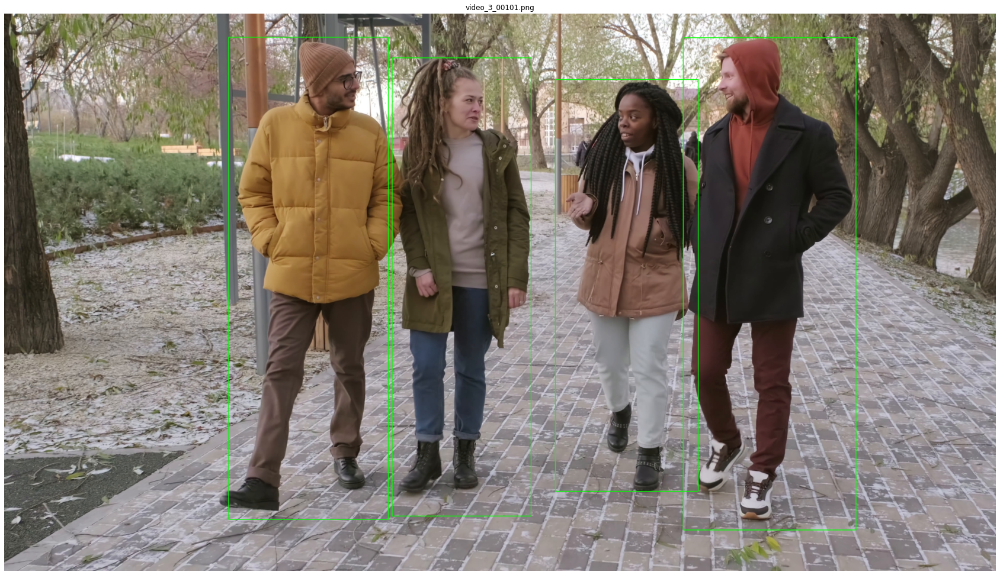

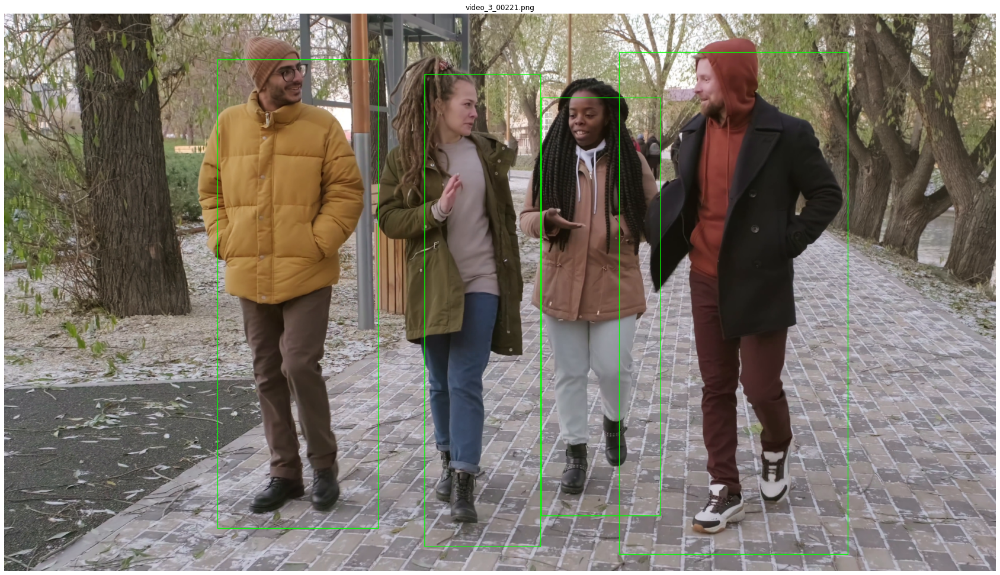

In [122]:
img_dir = '/data1/r_suzuki/pipeline/BaseModel/data/person_attribute_demo_4/raw/images'
plot_bboxes(detection_result_df, img_dir, pred_images_dir=None, resize=False, save_images=False, only_bbox=True)

In [109]:
detection_result = pd.read_pickle('/data1/r_suzuki/pipeline/BaseModel/models/effdet_person_ca_v5/20201010_00_40_05/result/person_attribute_demo/result_2.pkl')

FileNotFoundError: [Errno 2] No such file or directory: '/data1/r_suzuki/pipeline/BaseModel/models/effdet_person_ca_v5/20201010_00_40_05/result/person_attribute_demo/result_2.pkl'

In [110]:
detection_result.class_id.unique()

array([1])

In [100]:
detection_result

,image_id,image_path,class_id,conf,xmin,ymin,xmax,ymax,object_id
0,P1033674_00021.png,/data1/r_suzuki/pipeline/BaseModel/data/person...,1,0.525638,9,296,102,637,P1033674_00021_0.jpg
1,P1033674_00023.png,/data1/r_suzuki/pipeline/BaseModel/data/person...,1,0.430403,35,301,129,639,P1033674_00023_1.jpg
2,P1033674_00028.png,/data1/r_suzuki/pipeline/BaseModel/data/person...,1,0.590595,89,279,183,635,P1033674_00028_2.jpg
3,P1033674_00029.png,/data1/r_suzuki/pipeline/BaseModel/data/person...,1,0.590595,89,279,183,635,P1033674_00029_3.jpg
4,P1033674_00030.png,/data1/r_suzuki/pipeline/BaseModel/data/person...,1,0.530758,100,281,195,629,P1033674_00030_4.jpg
...,...,...,...,...,...,...,...,...,...
590,P1033674_01183.png,/data1/r_suzuki/pipeline/BaseModel/data/person...,1,0.453340,436,341,510,633,P1033674_01183_590.jpg
591,P1033674_01187.png,/data1/r_suzuki/pipeline/BaseModel/data/person...,1,0.508222,479,320,579,633,P1033674_01187_591.jpg
592,P1033674_01188.png,/data1/r_suzuki/pipeline/BaseModel/data/person...,1,0.558871,493,313,602,634,P1033674_01188_592.jpg
593,P1033674_01190.png,/data1/r_suzuki/pipeline/BaseModel/data/person...,1,0.482306,501,321,618,638,P1033674_01190_593.jpg


In [101]:
df_2 = pd.merge(detection_result, cls_result, left_on='object_id', right_on='object_id')

In [102]:
df_2

,image_id,image_path,class_id,conf,xmin,ymin,xmax,ymax,object_id,attr_id
0,P1033674_00021.png,/data1/r_suzuki/pipeline/BaseModel/data/person...,1,0.525638,9,296,102,637,P1033674_00021_0.jpg,1 6


In [146]:
df = pd.read_pickle('../../models/resnet50_defaults_blur/20201221_18_35_00/result/person_attribute_demo_4/person_attribute_demo_4.pkl')

In [147]:
df

,image_id,image_path,id,class_id,outside,occluded,keyframe,xmin,ymin,xmax,ymax,z_order,image_height,image_width,width,height,area,object_id,attr_id
0,00001,/data1/r_suzuki/pipeline/BaseModel/data/person...,2.0,1,0.0,0.0,1.0,2149.0,248.0,2705.0,1908.0,8.0,2160.0,3840.0,556.0,1660.0,922960.0,00001_0.jpg,2 5
1,00001,/data1/r_suzuki/pipeline/BaseModel/data/person...,1.0,1,0.0,0.0,1.0,1514.0,161.0,2092.0,1950.0,6.0,2160.0,3840.0,578.0,1789.0,1034042.0,00001_1.jpg,2 3 5
2,00001,/data1/r_suzuki/pipeline/BaseModel/data/person...,0.0,1,0.0,0.0,1.0,839.0,68.0,1509.0,1953.0,5.0,2160.0,3840.0,670.0,1885.0,1262950.0,00001_2.jpg,2 6
3,00001,/data1/r_suzuki/pipeline/BaseModel/data/person...,3.0,1,0.0,0.0,1.0,2661.0,110.0,3327.0,2074.0,9.0,2160.0,3840.0,666.0,1964.0,1308024.0,00001_3.jpg,2 6
4,00002,/data1/r_suzuki/pipeline/BaseModel/data/person...,0.0,1,0.0,0.0,0.0,837.0,68.0,1509.0,1961.0,5.0,2160.0,3840.0,672.0,1893.0,1272096.0,00002_4.jpg,2 6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1631,00408,/data1/r_suzuki/pipeline/BaseModel/data/person...,0.0,1,0.0,0.0,0.0,799.0,130.0,1415.0,1881.0,5.0,2160.0,3840.0,616.0,1751.0,1078616.0,00408_1629.jpg,2 6
1632,00409,/data1/r_suzuki/pipeline/BaseModel/data/person...,2.0,1,0.0,0.0,0.0,2136.0,267.0,2609.0,1867.0,8.0,2160.0,3840.0,473.0,1600.0,756800.0,00409_1633.jpg,2 5
1633,00409,/data1/r_suzuki/pipeline/BaseModel/data/person...,3.0,1,0.0,0.0,0.0,2616.0,140.0,3179.0,2057.0,9.0,2160.0,3840.0,563.0,1917.0,1079271.0,00409_1634.jpg,2 3 6
1634,00409,/data1/r_suzuki/pipeline/BaseModel/data/person...,1.0,1,0.0,0.0,0.0,1558.0,186.0,2077.0,1877.0,6.0,2160.0,3840.0,519.0,1691.0,877629.0,00409_1632.jpg,2 3 6


In [148]:
assert df.isnull().sum(axis = 0).sum() == 0

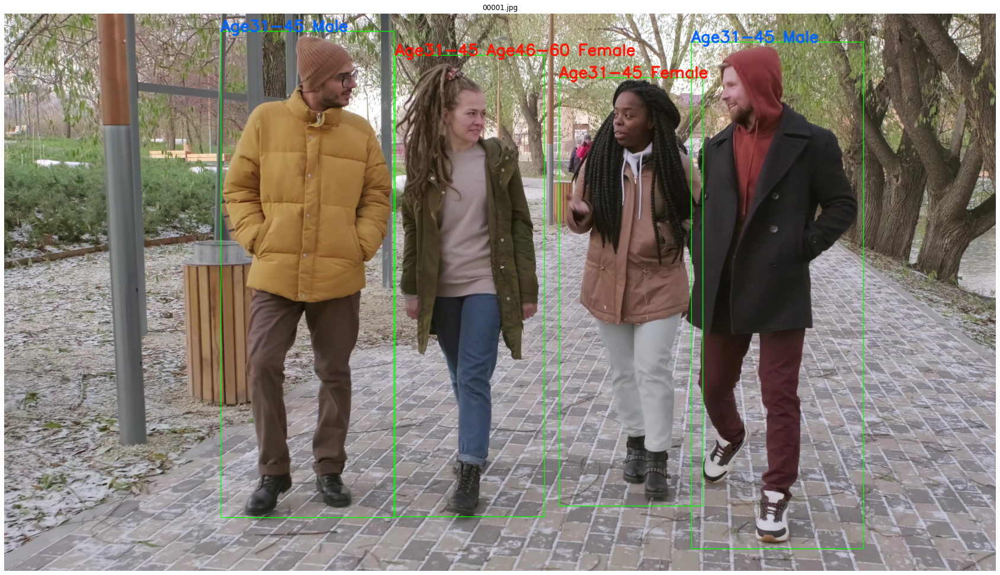

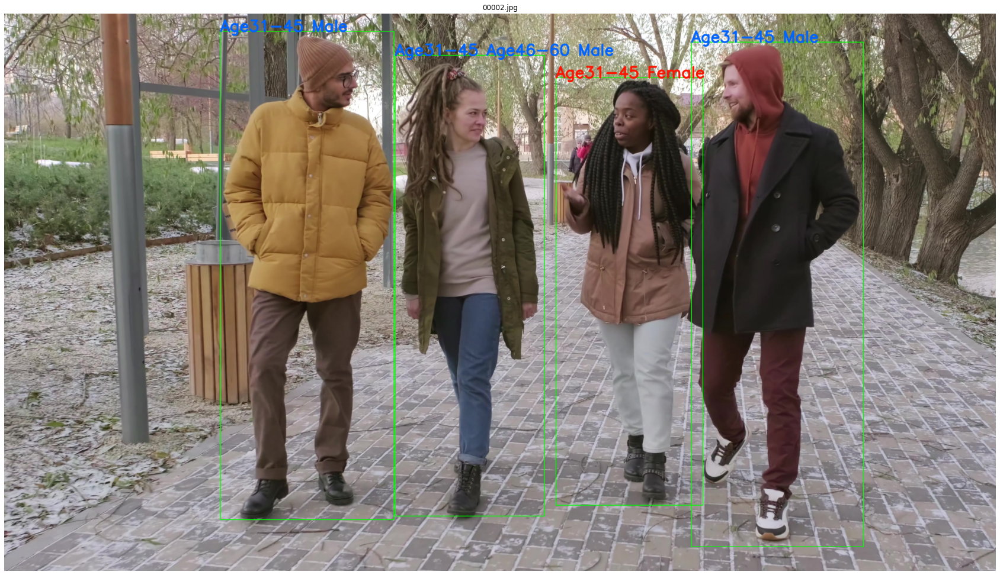

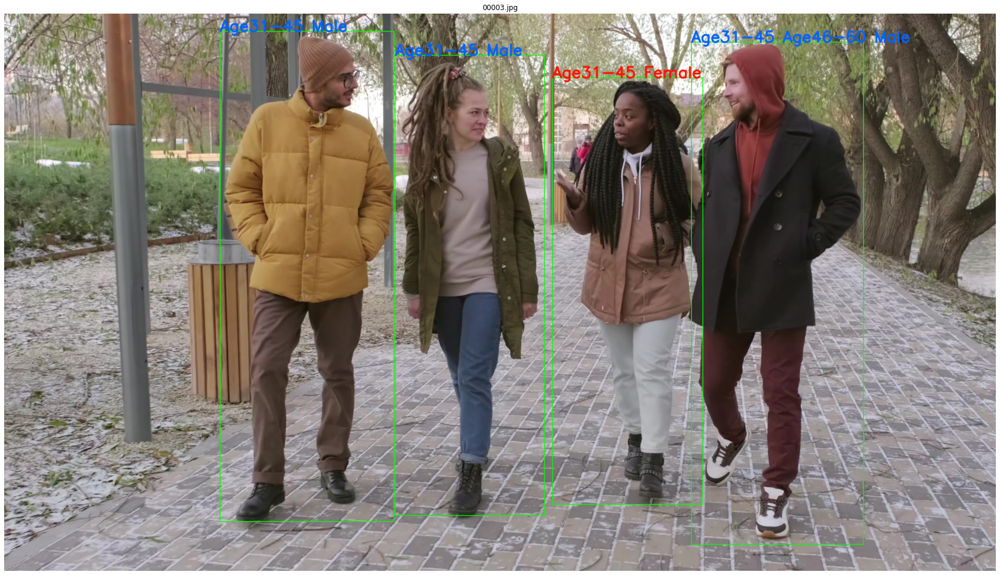

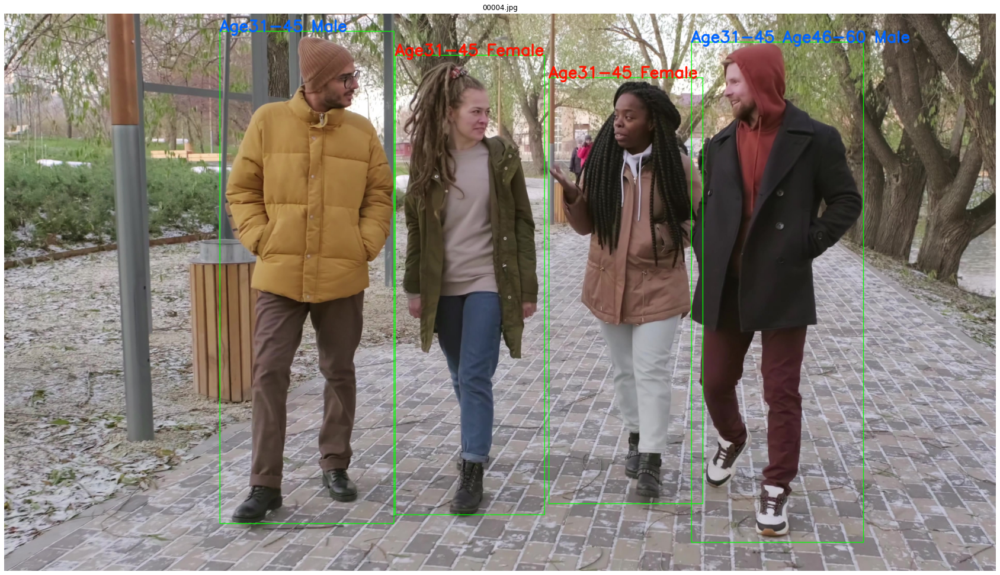

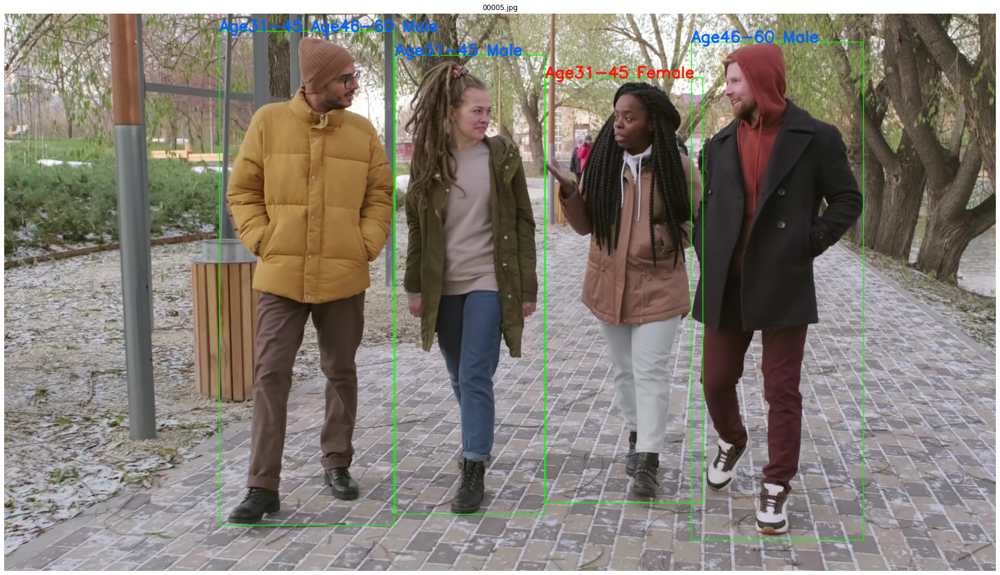

In [149]:
img_dir = '/data1/r_suzuki/pipeline/BaseModel/data/person_attribute_demo_4/raw/images'
plot_bboxes(df, img_dir, pred_images_dir=None, resize=False, save_images=False, only_bbox=False)